# 29837043_Scenario_1

- Module Code: CSMAD21
- Assignment Report Title: Applied Data Science with Python
- Student Number: 29837043 
- Date (when the work completed): Jan 1st, 2022 
- Actual hrs spent for the assignment:  25 hrs
- Assignment evaluation (3 key points): 
    - 1. Excited to work on Python for dissertation
    - 2. Good experience to work something new that wasn't my background
    - 3. Learned a lot of concepts for the first time
                                        

### Scenario_1_Twitter network map: Task_1_Data Gathering, Pre-processing and EDA

<span style="color:blue"><b>Step A: Importing the required libraries</b></span>

In [2]:
# Typical liubraries for data analysis [1]
%matplotlib inline
from config import *
import tweepy
import datetime
import pandas as pd
import string
import re
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl
import networkx as nx
import numpy as np
import json
import csv
import requests

##Libraries needed for training the clustering algorithms
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture as GMM

##Libraries needed for the additional functions and metrics: 
from sklearn.metrics import silhouette_score
from scipy.spatial.distance import cdist
from matplotlib.patches import Ellipse

##Needed for normalisation
from sklearn import preprocessing


<span style="color:blue"><b>Step B: API connection</b></span>

In [356]:
api_key=""
api_key_secret=""
access_token=""
access_token_secret=""
auth = tweepy.OAuthHandler(api_key, api_key_secret)
auth.set_access_token(access_token, access_token_secret)
api = tweepy.API(auth,wait_on_rate_limit=True)

In [372]:
# Reading today's and yesterday's datetime
today = datetime.date.today()
yesterday = today - datetime.timedelta(days=1)
daysago = today - datetime.timedelta(days=90)
today,yesterday,daysago

(datetime.date(2021, 12, 30),
 datetime.date(2021, 12, 29),
 datetime.date(2021, 10, 1))

<span style="color:blue"><b>Step C: Data extraction from the data source</b></span>

In [394]:
# Run the api to fetch the 900 tweets of three influencers [2]

# Defining an empty list
outputlist = []

# Creating a list of all search keywords for which data should be retreived
search_keywords = ["Narendra Modi", "Akshay Kumar", "Nitin Gadkari" ]


# for loop will search for the keywords and creates a list with attributes
for eachelement in search_keywords:
    
    # Retreiving datasets as per the search_keywords from twitter
    tweets_list = tweepy.Cursor(api.search_tweets, q="from: " + eachelement, tweet_mode='extended', lang='en').items(300)
    
    # Updating the list with datasets
    for tweet in tweets_list:
        
        # Assigning attribute values to variables
        tweet_id = tweet.id
        text = tweet._json["full_text"]
        screen_name = tweet.user.screen_name
        retweeted = tweet.retweeted
        retweet_count = tweet.retweet_count
        followers_count = tweet.author.followers_count
        friends_count = tweet.author.friends_count
        location = tweet.author.location
        created_at = tweet.created_at
        line = {'influencer_name': eachelement,
                'tweet_id' : tweet_id, 
                'text' : text, 
                'screen_name' : screen_name,
                'retweeted': retweeted,
                'retweet_count' : retweet_count, 
                'followers_count' : followers_count, 
                'friends_count' : friends_count,
                'location' : location,
                'created_at' : created_at}
        
        # Updating the outputlist with the line list
        outputlist.append(line)
                


In [395]:
# Printing the final list of dataset
len(outputlist)

900

<span style="color:blue"><b>Step D: Transform the original data into a Pandas dataframe</b></span>

In [396]:
# Converting the list into Dataframe
df = pd.DataFrame(outputlist)
df.to_csv('outputlist.csv', mode='a', header=False)

# Saving the outputlist into csv file
df.to_csv('outputlist.csv')

In [397]:
# Check the dimension of dataframe
df.shape

(900, 10)

In [398]:
# Print few rows from dataframe
df.head()

,influencer_name,tweet_id,text,screen_name,retweeted,retweet_count,followers_count,friends_count,location,created_at
0,Narendra Modi,1476577689934831619,RT @maheshperi: PMs' and Cars: \n\nPVN: Ambass...,authentikAli,False,2254,225,387,New Delhi,2021-12-30 15:35:29+00:00
1,Narendra Modi,1476577620531630084,RT @maheshperi: PMs' and Cars: \n\nPVN: Ambass...,ramansrikanth,False,2254,345,522,,2021-12-30 15:35:12+00:00
2,Narendra Modi,1476577572741808131,RT @maheshperi: PMs' and Cars: \n\nPVN: Ambass...,SANGRAM59523763,False,2254,74,119,,2021-12-30 15:35:01+00:00
3,Narendra Modi,1476577535668330497,RT @maheshperi: PMs' and Cars: \n\nPVN: Ambass...,gr8india,False,2254,2360,1246,India,2021-12-30 15:34:52+00:00
4,Narendra Modi,1476577331682570242,RT @maheshperi: PMs' and Cars: \n\nPVN: Ambass...,ashrafh17,False,2254,62,1319,India,2021-12-30 15:34:04+00:00


<span style="color:blue"><b>Step E: Data Preprocessing</b></span>

In [399]:
# Reading the outputlist csv file and storing it in a dataframe
tweetdfdata = pd.read_csv('outputlist.csv')
tweetdfdata.head()

,Unnamed: 0,influencer_name,tweet_id,text,screen_name,retweeted,retweet_count,followers_count,friends_count,location,created_at
0,0,Narendra Modi,1476577689934831619,RT @maheshperi: PMs' and Cars: \n\nPVN: Ambass...,authentikAli,False,2254,225,387,New Delhi,2021-12-30 15:35:29+00:00
1,1,Narendra Modi,1476577620531630084,RT @maheshperi: PMs' and Cars: \n\nPVN: Ambass...,ramansrikanth,False,2254,345,522,NaN,2021-12-30 15:35:12+00:00
2,2,Narendra Modi,1476577572741808131,RT @maheshperi: PMs' and Cars: \n\nPVN: Ambass...,SANGRAM59523763,False,2254,74,119,NaN,2021-12-30 15:35:01+00:00
3,3,Narendra Modi,1476577535668330497,RT @maheshperi: PMs' and Cars: \n\nPVN: Ambass...,gr8india,False,2254,2360,1246,India,2021-12-30 15:34:52+00:00
4,4,Narendra Modi,1476577331682570242,RT @maheshperi: PMs' and Cars: \n\nPVN: Ambass...,ashrafh17,False,2254,62,1319,India,2021-12-30 15:34:04+00:00


In [400]:
# Rename the Unnamed:0 column to Row_No
tweetdfdata.rename( columns={'Unnamed: 0':'Row_No'}, inplace=True )

In [401]:
# Find the total number of missing values
tweetdfdata.isnull().sum()

Row_No               0
influencer_name      0
tweet_id             0
text                 0
screen_name          0
retweeted            0
retweet_count        0
followers_count      0
friends_count        0
location           357
created_at           0
dtype: int64

In [402]:
# Remove any missing values
tweetdfdata2 = tweetdfdata.dropna().copy()
tweetdfdata2.isnull().sum()

Row_No             0
influencer_name    0
tweet_id           0
text               0
screen_name        0
retweeted          0
retweet_count      0
followers_count    0
friends_count      0
location           0
created_at         0
dtype: int64

In [403]:
# Fill in all the missing values with "NA"
tweetdfdata2 = tweetdfdata2.fillna("NA")
tweetdfdata2.isnull().sum()

Row_No             0
influencer_name    0
tweet_id           0
text               0
screen_name        0
retweeted          0
retweet_count      0
followers_count    0
friends_count      0
location           0
created_at         0
dtype: int64

In [404]:
# Find the duplicate values
tweetdfdata2.duplicated().sum()

0

In [405]:
# Check the data types of all attributes
tweetdfdata2.dtypes

Row_No              int64
influencer_name    object
tweet_id            int64
text               object
screen_name        object
retweeted            bool
retweet_count       int64
followers_count     int64
friends_count       int64
location           object
created_at         object
dtype: object

In [406]:
# Change the data type of text, author, screen_name, location and created_at to string [3]
tweetdfdata2['influencer_name'] = tweetdfdata2['influencer_name'].astype('string')
tweetdfdata2['text'] = tweetdfdata2['text'].astype('string')
tweetdfdata2['screen_name'] = tweetdfdata2['screen_name'].astype('string')
tweetdfdata2['location'] = tweetdfdata2['location'].astype('string')
tweetdfdata2['created_at'] = tweetdfdata2['created_at'].astype('string')

# Change the data type of tweet_id, favourite_count, retweet_count, followers_count, friends_count, statuses_count, listed_count to float
tweetdfdata2['tweet_id'] = tweetdfdata2['tweet_id'].astype('int64')
tweetdfdata2['retweet_count'] = tweetdfdata2['retweet_count'].astype('int64')
tweetdfdata2['followers_count'] = tweetdfdata2['followers_count'].astype('int64')
tweetdfdata2['friends_count'] = tweetdfdata2['friends_count'].astype('int64')


In [407]:
# check if there is anything unusual
tweetdfdata2.describe()

,Row_No,tweet_id,retweet_count,followers_count,friends_count
count,543.000000,5.430000e+02,543.000000,5.430000e+02,543.000000
mean,446.519337,1.476272e+18,569.848987,3.304266e+04,838.151013
std,266.545744,3.513413e+14,912.259827,3.644884e+05,1779.899727
min,0.000000,1.475494e+18,0.000000,0.000000e+00,2.000000
25%,208.500000,1.476046e+18,1.000000,5.100000e+01,109.000000
50%,450.000000,1.476463e+18,40.000000,2.350000e+02,338.000000
75%,678.000000,1.476556e+18,998.000000,8.640000e+02,784.000000
max,899.000000,1.476578e+18,2254.000000,5.896677e+06,23802.000000


<span style="color:blue"><b>Step F: Data Cleansing activity</b></span>

In [408]:
# Verifying the size of dataframe
tweetdfdata2.shape

(543, 11)

In [409]:
# Remove emojis from dataframe
tweetdfdata2 = tweetdfdata2.astype(str).apply(lambda x: x.str.encode('ascii', 'ignore').str.decode('ascii'))
tweetdfdata2.head(2)

,Row_No,influencer_name,tweet_id,text,screen_name,retweeted,retweet_count,followers_count,friends_count,location,created_at
0,0,Narendra Modi,1476577689934831619,RT @maheshperi: PMs' and Cars: \n\nPVN: Ambass...,authentikAli,False,2254,225,387,New Delhi,2021-12-30 15:35:29+00:00
3,3,Narendra Modi,1476577535668330497,RT @maheshperi: PMs' and Cars: \n\nPVN: Ambass...,gr8india,False,2254,2360,1246,India,2021-12-30 15:34:52+00:00


In [410]:
# Remove the punctuation from text and location attributes [4]

string.punctuation
'!"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~'

def remove_punct(textin):
    textin  = "".join([char for char in textin if char not in string.punctuation])
    textin = re.sub('[0-9]+', '', textin)
    return textin

# Removing pattern of \n\n and space from columns
tweetdfdata2['text'] = tweetdfdata2['text'].str.replace('\n\n', '')
tweetdfdata2['screen_name'] = tweetdfdata2['screen_name'].str.replace(' ', '')
tweetdfdata2['influencer_name'] = tweetdfdata2['influencer_name'].str.replace(' ', '')
tweetdfdata2['location'] = tweetdfdata2['location'].str.replace(' ', '')

# Setting the text column with the return values of remove_punct function
tweetdfdata2['text'] = tweetdfdata2['text'].apply(lambda x: remove_punct(x))
tweetdfdata2['screen_name'] = tweetdfdata2['screen_name'].apply(lambda x: remove_punct(x))
tweetdfdata2['influencer_name'] = tweetdfdata2['influencer_name'].apply(lambda x: remove_punct(x))
tweetdfdata2['location'] = tweetdfdata2['location'].apply(lambda x: remove_punct(x))

tweetdfdata2.head()


,Row_No,influencer_name,tweet_id,text,screen_name,retweeted,retweet_count,followers_count,friends_count,location,created_at
0,0,NarendraModi,1476577689934831619,RT maheshperi PMs and Cars PVN Ambassador \nIK...,authentikAli,False,2254,225,387,NewDelhi,2021-12-30 15:35:29+00:00
3,3,NarendraModi,1476577535668330497,RT maheshperi PMs and Cars PVN Ambassador \nIK...,grindia,False,2254,2360,1246,India,2021-12-30 15:34:52+00:00
4,4,NarendraModi,1476577331682570242,RT maheshperi PMs and Cars PVN Ambassador \nIK...,ashrafh,False,2254,62,1319,India,2021-12-30 15:34:04+00:00
6,6,NarendraModi,1476576657246810113,RT maheshperi PMs and Cars PVN Ambassador \nIK...,hiessdee,False,2254,704,1588,LandofMaaKali,2021-12-30 15:31:23+00:00
7,7,NarendraModi,1476576617287745536,RT Anuragkukreti Narendra Modi buying a railwa...,AbhaykumarInc,False,998,929,845,PatnaIndia,2021-12-30 15:31:13+00:00


In [411]:
# Change the date format of created_at attribute [5]

for i in range(len(tweetdfdata2['created_at'])):
    sample_series = tweetdfdata2['created_at'].values
    tweetdfdata2['created_at'] = pd.to_datetime(sample_series).strftime('%Y-%m-%d')

tweetdfdata2.head(2)


,Row_No,influencer_name,tweet_id,text,screen_name,retweeted,retweet_count,followers_count,friends_count,location,created_at
0,0,NarendraModi,1476577689934831619,RT maheshperi PMs and Cars PVN Ambassador \nIK...,authentikAli,False,2254,225,387,NewDelhi,2021-12-30
3,3,NarendraModi,1476577535668330497,RT maheshperi PMs and Cars PVN Ambassador \nIK...,grindia,False,2254,2360,1246,India,2021-12-30


<span style="color:blue"><b>Step G: Exploratory Data Analysis</b></span>

<span style="color:blue">To start the exploratory data analysis, below types of plots has been built using full dataset
<br>
    <body>1. Count plot for followers_count
    <br>2. Histogram for followers_count and retweet_count
    <br>3. Histogram for followers_count and retweet_count
    <br>4. Joint plot using Histogram for followers_count and retweet_count
    <br>5. Joint plot using Scatter plot for followers_count and retweet_count</body>
</span>

<AxesSubplot:xlabel='followers_count', ylabel='count'>

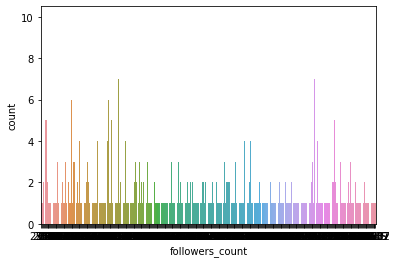

In [412]:
# 1. Plot a count plot to identify the count of followers_count using full dataset
sns.countplot(x = 'followers_count', data = tweetdfdata2)

(array([66., 56., 68., 44., 62., 51., 46., 46., 60., 44.]),
 array([  0. ,  37.7,  75.4, 113.1, 150.8, 188.5, 226.2, 263.9, 301.6,
        339.3, 377. ]),
 <BarContainer object of 10 artists>)

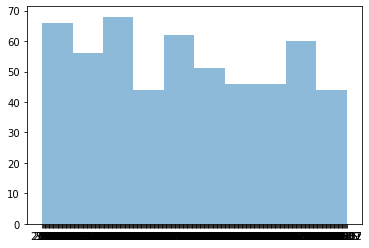

In [413]:
# 2. Plot histogram for followers_count using full dataset
plt.hist(tweetdfdata2['followers_count'], bins=10, alpha=0.5)

(array([160.,  29., 135.,  27.,  75.,  21.,  53.,  10.,  16.,  17.]),
 array([ 0. ,  2.9,  5.8,  8.7, 11.6, 14.5, 17.4, 20.3, 23.2, 26.1, 29. ]),
 <BarContainer object of 10 artists>)

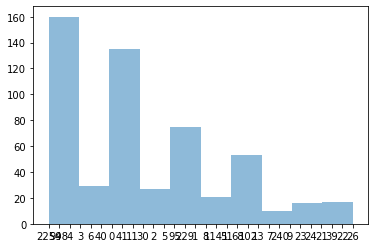

In [414]:
# 3. Plot histogram for retweet_count using full dataset
plt.hist(tweetdfdata2['retweet_count'], bins=10, alpha=0.5)

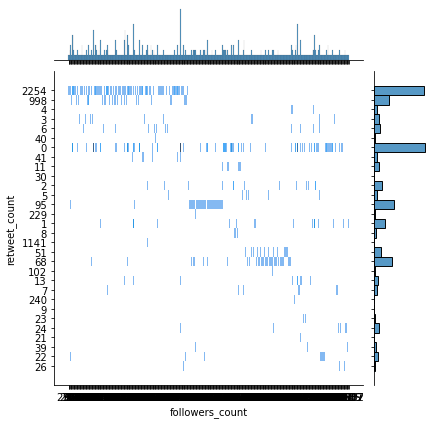

In [415]:
# 4. Plot a histogram jointplot with followers_count and retweet_count using full dataset
sns.jointplot(x='followers_count',y='retweet_count',data=tweetdfdata2, kind='hist')

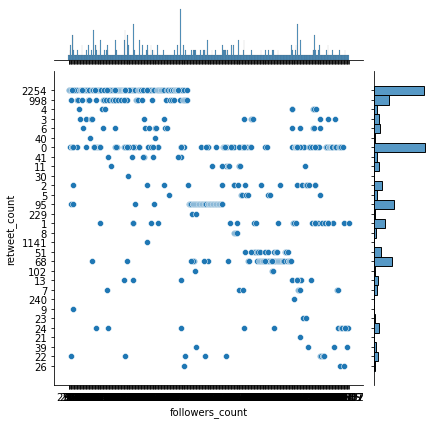

In [416]:
# 5. Plot a scatter jointplot with followers_count and retweet_count using full dataset
sns.jointplot(x='followers_count',y='retweet_count',data=tweetdfdata2, kind='scatter')

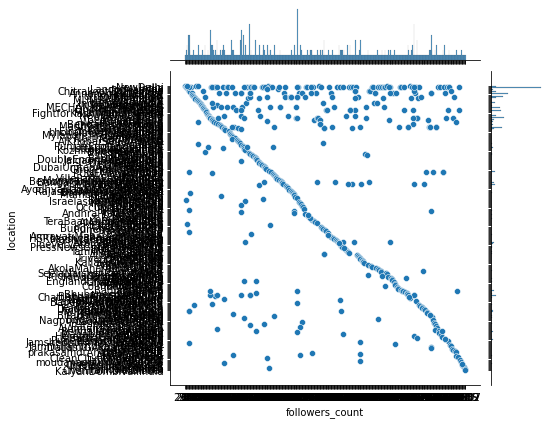

In [417]:
# 5. Plot a scatter jointplot with followers_count and retweet_count using full dataset
sns.jointplot(x='followers_count',y='location',data=tweetdfdata2, kind='scatter')

<span style="color:blue">
    <body>None of the plots above are very clear to understand the data for followers_count and retweet_count and hence creating a new dataframe to store only 10 rows.
    <br>The below plots has been built to get a clear view 
    <br>1. Count plot for followers_count
    <br>2. Count plot for retweet_count
    <br>3. Joint plot using Histogram for followers_count and retweet_count
    <br>4. Joint plot using Scatter plot for followers_count and retweet_count
    </body></span>

In [418]:
# Select the top 5 rows and bottom 5 rows from 900 rows to have a clear plot
tweetdfdata3 = tweetdfdata2.head(5)
tweetdfdata4 = tweetdfdata2.tail(5)
tweetdfdata3 = tweetdfdata3.append(tweetdfdata4)
tweetdfdata3.shape

(10, 11)

<AxesSubplot:xlabel='followers_count', ylabel='count'>

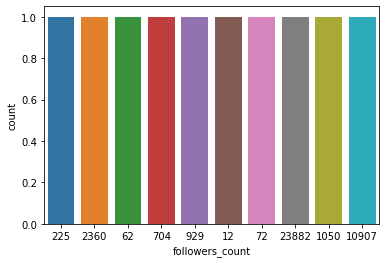

In [419]:
# 1. Plot a count plot to identify the count of followers_count using 10 rows
sns.countplot(x = 'followers_count', data = tweetdfdata3)

<AxesSubplot:xlabel='retweet_count', ylabel='count'>

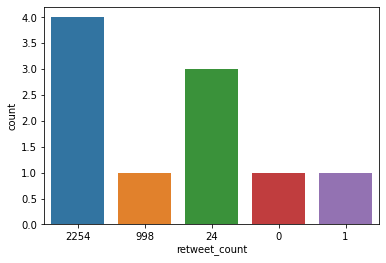

In [420]:
# 2. Plot a count plot to identify the count of retweet_count using 10 rows
sns.countplot(x = 'retweet_count', data = tweetdfdata3)

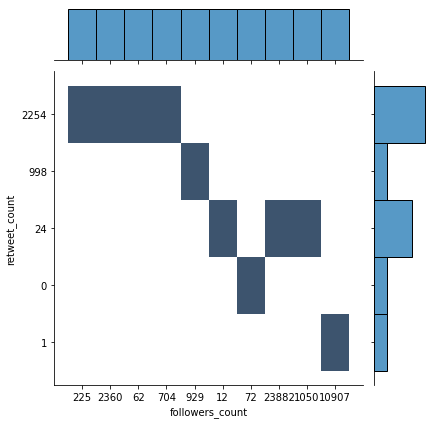

In [421]:
# 3. Plot a histogram jointplot with followers_count and retweet_count using 10 rows
sns.jointplot(x='followers_count',y='retweet_count',data=tweetdfdata3, kind='hist')

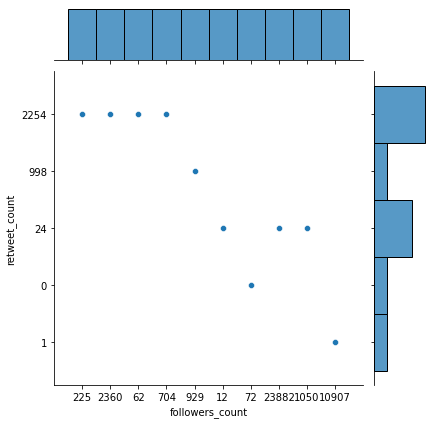

In [422]:
# 4. Plot a scatter jointplot with followers_count and retweet_count using 10 rows
sns.jointplot(x='followers_count',y='retweet_count',data=tweetdfdata3, kind='scatter')

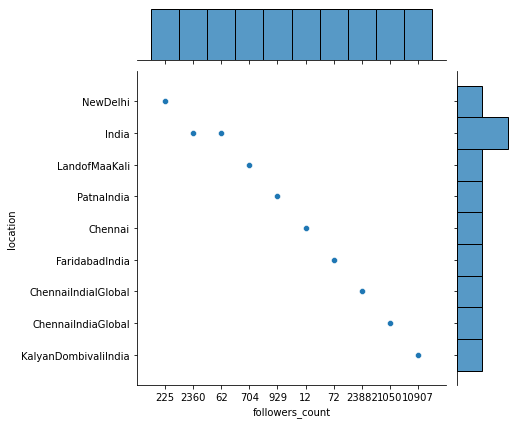

In [423]:
# 4. Plot a scatter jointplot with followers_count and retweet_count using 10 rows
sns.jointplot(x='followers_count',y='location',data=tweetdfdata3, kind='scatter')

<span style="color:blue"><b>Step H: Explanation of defferent plot</b>
    <body><br>The plots having the whole set of twitter data, were not clear to record the outcomes and hence stored 10 rows from the full dataset and plotted histogram and scatter plot. 
        <br>The joint plot of histogram and scatter plot are specifying the trend of follower_counts and the retweet_count
        <br>The last scatter plot is showing the trend of follower_counts against their location, 
    <br></body>
</span>

### Scenario_1_Twitter network map_Task_2_Network analysis

<span style="color:blue"><b>Step A: Creating a dataset with the Influencers and followers</b></span>

In [428]:
# Find the tweets where retweet_count is not 0 from the dataset analysed in Task 1 above [6]
tweetdfdata5 = tweetdfdata2.loc[tweetdfdata2['retweet_count']!='0']


In [433]:
# Take 2 columns 'influencer_name','screen_name' into new dataframe
followers_data = tweetdfdata5[['influencer_name','screen_name']]

In [434]:
followers_data

,influencer_name,screen_name
0,NarendraModi,authentikAli
3,NarendraModi,grindia
4,NarendraModi,ashrafh
6,NarendraModi,hiessdee
7,NarendraModi,AbhaykumarInc
...,...,...
892,NitinGadkari,Sankeer
893,NitinGadkari,MCpravin
896,NitinGadkari,AgnishwarJ
898,NitinGadkari,garudaindia


<span style="color:blue"><b>Step B: Transform the followers data into a Pandas dataframe and save it in a .tsv file</b></span>

In [435]:
# Save the followers_data to .tsv file
pd.DataFrame(followers_data).to_csv("followers_data.tsv", sep="\t", index=False,header=False,quoting=csv.QUOTE_NONE)

<span style="color:blue"><b>Step C: Creating edge list</b></span>

In [436]:
# Creating edge list
with open("followers_data.tsv") as f:
    el = (list(map(str,l.split())) for l in f)
    zebra = nx.from_edgelist(el)
g = zebra

In [437]:
g.number_of_nodes(), g.number_of_edges()

(401, 400)

In [438]:
g.nodes(), g.edges()

(NodeView(('NarendraModi', 'authentikAli', 'grindia', 'ashrafh', 'hiessdee', 'AbhaykumarInc', 'ankush', 'alwaysbhushan', 'Devanat', 'ArjunK', 'abhishekdixitg', 'vyasyash', 'katizzcool', 'MiteshT', 'ManavCule', 'sameermumbaikr', 'YUVAGAN', 'sandeepkathe', 'surianil', 'kalranet', 'ayubkhan', 'VetrivelRajaram', 'AurBataoo', 'DURAICHARLES', 'saineeji', 'SudanShashank', 'RoflPhooka', 'SPARTAAA', 'Shaileshr', 'NiteshKPatra', 'Sandipsingh', 'AdharmaDharma', 'poonambjp', 'divineslap', 'mannkibaat', 'MuraliMohanRat', 'reyvikas', 'salmanqd', 'kishalay', 'lvlzee', 'mohdIqbalkazi', 'UnknownKhiladi', 'RoshanPalla', 'MangaleshShiva', 'SadatAliKhan', 'Commonman', 'livemanish', 'SyedFHasan', 'Rahilqu', 'ANICMA', 'GandhiTalks', 'ashfaaaque', 'PrayRona', 'ajdutta', 'rvgindia', 'YagyaDutta', 'Jatinder', 'lucozain', 'Bhaweshkj', 'UjwalAnurag', 'IncSatyamc', 'LovelyS', 'jamsadm', 'PVasanthibai', 'Mohamme', 'vinod', 'SUNILK', 'coljsrana', 'MahendraR', 'viveksekhar', 'crahul', 'TamilanNomadic', 'ReemKhan', '

<span style="color:blue"><b>Step D: Properties of the network</b></span>

In [440]:
# Degree of a particular node
nx.degree(g,'NarendraModi')

182

In [441]:
# Find the degree of all the nodes
degrees = []

for n in g.nodes(): 
    degrees.append(nx.degree(g,n))
degrees

[182,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 2,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 2,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 133,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,


In [442]:
# Print the miximum and minimum degrees
print(max(degrees))
print(min(degrees))

182
1


In [443]:
sum(degrees)/len(degrees)

1.9950124688279303

In [444]:
# Connected Components
nx.number_connected_components(g)

1

In [445]:
# Verifying if the graph is connected
nx.is_connected(g)

True

In [446]:
# Diameter: for undirected graph
nx.diameter(g)

6

In [447]:
# Shortest Path
nx.shortest_path(g)

{'NarendraModi': {'NarendraModi': ['NarendraModi'],
  'authentikAli': ['NarendraModi', 'authentikAli'],
  'grindia': ['NarendraModi', 'grindia'],
  'ashrafh': ['NarendraModi', 'ashrafh'],
  'hiessdee': ['NarendraModi', 'hiessdee'],
  'AbhaykumarInc': ['NarendraModi', 'AbhaykumarInc'],
  'ankush': ['NarendraModi', 'ankush'],
  'alwaysbhushan': ['NarendraModi', 'alwaysbhushan'],
  'Devanat': ['NarendraModi', 'Devanat'],
  'ArjunK': ['NarendraModi', 'ArjunK'],
  'abhishekdixitg': ['NarendraModi', 'abhishekdixitg'],
  'vyasyash': ['NarendraModi', 'vyasyash'],
  'katizzcool': ['NarendraModi', 'katizzcool'],
  'MiteshT': ['NarendraModi', 'MiteshT'],
  'ManavCule': ['NarendraModi', 'ManavCule'],
  'sameermumbaikr': ['NarendraModi', 'sameermumbaikr'],
  'YUVAGAN': ['NarendraModi', 'YUVAGAN'],
  'sandeepkathe': ['NarendraModi', 'sandeepkathe'],
  'surianil': ['NarendraModi', 'surianil'],
  'kalranet': ['NarendraModi', 'kalranet'],
  'ayubkhan': ['NarendraModi', 'ayubkhan'],
  'VetrivelRajaram':

<span style="color:blue"><b>Step E: Draw the network</b></span>

<span style="color:blue">
    <b></b>
        <body>Updated packages by "conda update --all" because an error "random_state_index is incorrect" was displayed while running the below code for creating graph</body>
</span>

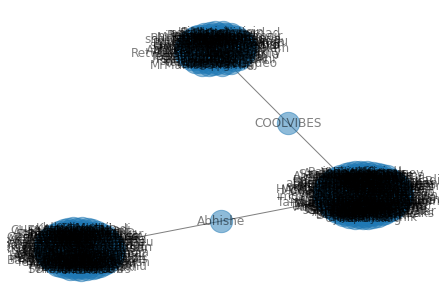

In [451]:
layout = nx.spring_layout(g)
nx.draw(g,pos=layout,node_size=500,alpha=0.5,with_labels=True)

In [452]:
# Define a function to find the neighbors
def neighbors(g, n):
    return list(g.neighbors(n))

In [517]:
# Find the common neighbor
list1 = []
list2 = []
list3 = []
commonneighbor = []

for eachnm in neighbors(g,'NarendraModi'):
    for eachak in neighbors(g,'AkshayKumar'):
        if eachnm == eachak:
            list1.append(eachnm)
    for eachng in neighbors(g,'NitinGadkari'):
        if eachnm == eachng:
            list2.append(eachng)
        if eachak == eachng:
            list3.append(eachak)

commonneighbor = list1 + list2 +list3

In [518]:
print('The common neighbor is: ',commonneighbor)

The common neighbor is:  ['Abhishe', 'COOLVIBES']


In [504]:
# Create a directed graph [7]
G = nx.DiGraph()

for row in followers_data.itertuples(index=False):
    a, b = row[:2]
    G.add_edge(a,b)
    H = G.to_directed()
    list(H.edges)


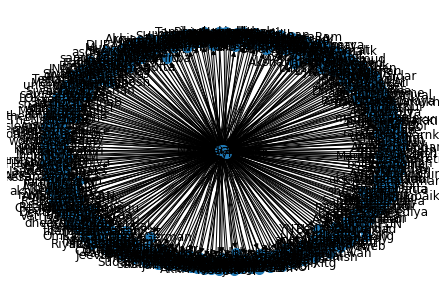

In [519]:
# Draw directed graph
layout = nx.spring_layout(G)
nx.draw(G,pos=layout,node_size=100,alpha=1,with_labels=True)

<span style="color:blue"><b>Step F: Stats on full dataset</b>
    <br>1.Degree Distribution
    <br>2.Cluster Coefficient
    <br>3.Betweenness Centrality
    <br>4.Assortativity
</span>

Text(0, 0.5, 'Frequency')

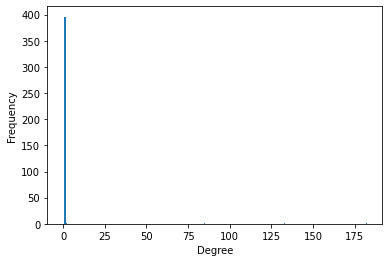

In [506]:
# 1. Degree Distribution
plt.bar(range(0,len(nx.degree_histogram(g))),nx.degree_histogram(g))
plt.xlabel("Degree")
plt.ylabel("Frequency")

In [507]:
# 2. Cluster Coefficient
cc = nx.clustering(g)
cc

{'NarendraModi': 0,
 'authentikAli': 0,
 'grindia': 0,
 'ashrafh': 0,
 'hiessdee': 0,
 'AbhaykumarInc': 0,
 'ankush': 0,
 'alwaysbhushan': 0,
 'Devanat': 0,
 'ArjunK': 0,
 'abhishekdixitg': 0,
 'vyasyash': 0,
 'katizzcool': 0,
 'MiteshT': 0,
 'ManavCule': 0,
 'sameermumbaikr': 0,
 'YUVAGAN': 0,
 'sandeepkathe': 0,
 'surianil': 0,
 'kalranet': 0,
 'ayubkhan': 0,
 'VetrivelRajaram': 0,
 'AurBataoo': 0,
 'DURAICHARLES': 0,
 'saineeji': 0,
 'SudanShashank': 0,
 'RoflPhooka': 0,
 'SPARTAAA': 0,
 'Shaileshr': 0,
 'NiteshKPatra': 0,
 'Sandipsingh': 0,
 'AdharmaDharma': 0,
 'poonambjp': 0,
 'divineslap': 0,
 'mannkibaat': 0,
 'MuraliMohanRat': 0,
 'reyvikas': 0,
 'salmanqd': 0,
 'kishalay': 0,
 'lvlzee': 0,
 'mohdIqbalkazi': 0,
 'UnknownKhiladi': 0,
 'RoshanPalla': 0,
 'MangaleshShiva': 0,
 'SadatAliKhan': 0,
 'Commonman': 0,
 'livemanish': 0,
 'SyedFHasan': 0,
 'Rahilqu': 0,
 'ANICMA': 0,
 'GandhiTalks': 0,
 'ashfaaaque': 0,
 'PrayRona': 0,
 'ajdutta': 0,
 'rvgindia': 0,
 'YagyaDutta': 0,
 'J

Text(0.5, 0, 'Clustering coeff.')

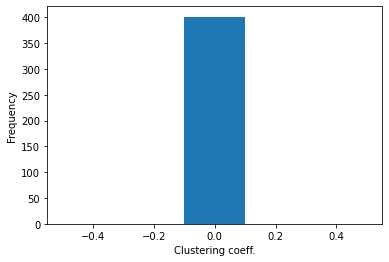

In [508]:
plt.hist(list(cc.values()),bins=5)
plt.ylabel("Frequency")
plt.xlabel("Clustering coeff.")

In [530]:
# 3. Betweenness Centrality
nx.betweenness_centrality(g)

{'NarendraModi': 0.842531328320802,
 'authentikAli': 0.0,
 'grindia': 0.0,
 'ashrafh': 0.0,
 'hiessdee': 0.0,
 'AbhaykumarInc': 0.0,
 'ankush': 0.0,
 'alwaysbhushan': 0.0,
 'Devanat': 0.0,
 'ArjunK': 0.0,
 'abhishekdixitg': 0.0,
 'vyasyash': 0.0,
 'katizzcool': 0.0,
 'MiteshT': 0.0,
 'ManavCule': 0.0,
 'sameermumbaikr': 0.0,
 'YUVAGAN': 0.0,
 'sandeepkathe': 0.0,
 'surianil': 0.0,
 'kalranet': 0.0,
 'ayubkhan': 0.0,
 'VetrivelRajaram': 0.0,
 'AurBataoo': 0.0,
 'DURAICHARLES': 0.0,
 'saineeji': 0.0,
 'SudanShashank': 0.0,
 'RoflPhooka': 0.0,
 'SPARTAAA': 0.0,
 'Shaileshr': 0.0,
 'NiteshKPatra': 0.0,
 'Sandipsingh': 0.0,
 'AdharmaDharma': 0.0,
 'poonambjp': 0.0,
 'divineslap': 0.0,
 'mannkibaat': 0.0,
 'MuraliMohanRat': 0.0,
 'reyvikas': 0.0,
 'salmanqd': 0.0,
 'kishalay': 0.0,
 'lvlzee': 0.0,
 'mohdIqbalkazi': 0.0,
 'UnknownKhiladi': 0.0,
 'RoshanPalla': 0.0,
 'MangaleshShiva': 0.0,
 'SadatAliKhan': 0.0,
 'Commonman': 0.0,
 'livemanish': 0.0,
 'SyedFHasan': 0.0,
 'Rahilqu': 0.0,
 'ANICM

In [510]:
# 4. Assortativility
nx.degree_assortativity_coefficient(g)

-0.8784883541772344

<span style="color:blue"><b>Step G: Modify the network</b></span>

In [511]:
## Remove all nodes with less than 2 degree
g2 = g.copy()
print(g2.nodes())

remove = [node for node,degree in dict(g2.degree()).items() if degree < 2]

g2.remove_nodes_from(remove)

print(g2.nodes())

['NarendraModi', 'authentikAli', 'grindia', 'ashrafh', 'hiessdee', 'AbhaykumarInc', 'ankush', 'alwaysbhushan', 'Devanat', 'ArjunK', 'abhishekdixitg', 'vyasyash', 'katizzcool', 'MiteshT', 'ManavCule', 'sameermumbaikr', 'YUVAGAN', 'sandeepkathe', 'surianil', 'kalranet', 'ayubkhan', 'VetrivelRajaram', 'AurBataoo', 'DURAICHARLES', 'saineeji', 'SudanShashank', 'RoflPhooka', 'SPARTAAA', 'Shaileshr', 'NiteshKPatra', 'Sandipsingh', 'AdharmaDharma', 'poonambjp', 'divineslap', 'mannkibaat', 'MuraliMohanRat', 'reyvikas', 'salmanqd', 'kishalay', 'lvlzee', 'mohdIqbalkazi', 'UnknownKhiladi', 'RoshanPalla', 'MangaleshShiva', 'SadatAliKhan', 'Commonman', 'livemanish', 'SyedFHasan', 'Rahilqu', 'ANICMA', 'GandhiTalks', 'ashfaaaque', 'PrayRona', 'ajdutta', 'rvgindia', 'YagyaDutta', 'Jatinder', 'lucozain', 'Bhaweshkj', 'UjwalAnurag', 'IncSatyamc', 'LovelyS', 'jamsadm', 'PVasanthibai', 'Mohamme', 'vinod', 'SUNILK', 'coljsrana', 'MahendraR', 'viveksekhar', 'crahul', 'TamilanNomadic', 'ReemKhan', 'pandeymaul

Diameter: 4


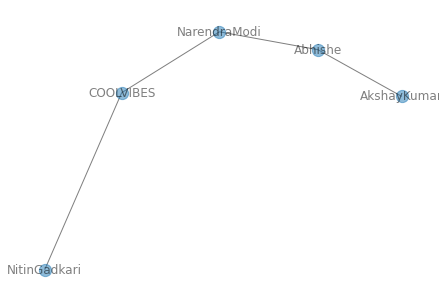

In [512]:
## Plot the network and get the new Diameter.
G2=g2
print('Diameter:', nx.diameter(G2))
layout = nx.spring_layout(G2)

nx.draw(G2,pos=layout,node_size=150,alpha=0.5, with_labels=True)

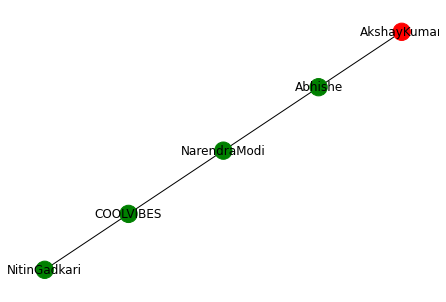

In [514]:
## Plot the graph with all nodes coloured in green and highlight the nodes with the fewest edges in red 

min_deg, min_node = 100, 100
for n in g2.nodes():
    deg = g2.degree(n)
    if g2.degree(n) < min_deg:
        min_deg = g2.degree(n)
        min_node = n
        
color_map = []
for node in g2:
    if node == min_node:
        color_map.append('red')
    else: 
        color_map.append('green')

nx.draw(g2, node_color=color_map, with_labels=True)
plt.show()

<span style="color:blue"><b>Step H: Stats on reduced graph</b>
    <br>1.Degree Distribution
    <br>2.Cluster Coefficient
    <br>3.Betweenness Centrality
    <br>4.Assortativity
</span>

Text(0, 0.5, 'Frequency')

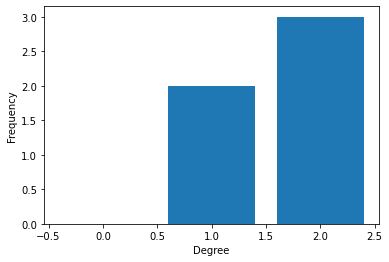

In [521]:
# 1. Degree Distribution
plt.bar(range(0,len(nx.degree_histogram(g2))),nx.degree_histogram(g2))
plt.xlabel("Degree")
plt.ylabel("Frequency")

In [524]:
# 2. Cluster Coefficient
cc1 = nx.clustering(g2)
cc1

{'NarendraModi': 0,
 'COOLVIBES': 0,
 'Abhishe': 0,
 'AkshayKumar': 0,
 'NitinGadkari': 0}

Text(0.5, 0, 'Clustering coeff.')

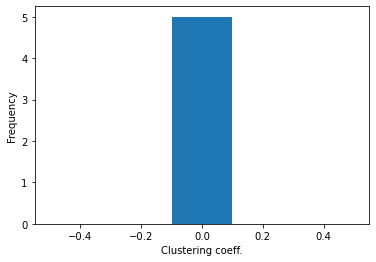

In [525]:
plt.hist(list(cc1.values()),bins=5)
plt.ylabel("Frequency")
plt.xlabel("Clustering coeff.")

In [526]:
# 3. Betweenness Centrality
nx.betweenness_centrality(g2)

{'NarendraModi': 0.6666666666666666,
 'COOLVIBES': 0.5,
 'Abhishe': 0.5,
 'AkshayKumar': 0.0,
 'NitinGadkari': 0.0}

In [527]:
# 4. Assortativility
nx.degree_assortativity_coefficient(g2)

-0.3333333333333333

<span style="color:blue"><b>Step I: Conclusion and lessons learned</b></span>

<span style="color:blue">
    <body>1. Took 900 tweets of 3 influencers "Narendra Modi", "Akshay Kumar" and "Nitin Gadkari", which then was reduced to 426 tweets based on conditions where retweet_count is not zero.
    <br>2. A network with all 426 tweets was drawn and the Stats was calculated
        <br> - Degree Distribution is showing near to 0
        <br> - Cluster Coefficient is also 0 for all nodes
        <br> - Betweenness Centrality is between 0.3 to 0.9 for 5 modes and the rest of the node shows 0.0
        <br> - Assortativility is -0.87848835
     <br>3. There are only 2 common nodes "COOLVIBES" and "Abhishe" between all 3 influencers, and hence took 5 followers to draw the network
        <br> - Degree Distribution is showing between 1.0 to 2.0
        <br> - Cluster Coefficient is showing 0 for all 5 nodes
        <br> - Betweenness Centrality is showing 0.5 for 2 nodes and 0.66 for 1 nodes
        <br> - Assortativility is -0.33333333
    </body>
    </span>

### References:
- [1] https://docs.tweepy.org/en/stable/install.html
- [2] https://towardsdatascience.com/how-to-build-a-dataset-from-twitter-using-python-tweepy-861bdbc16fa5
- [3] https://github.com/alod83/data-science/blob/master/Preprocessing/Formatting/Data%20Preprocessing%20-%20Formatting.ipynb
- [4] https://www.kaggle.com/ragnisah/text-data-cleaning-tweets-analysis
- [5] https://pandas.pydata.org/docs/reference/api/pandas.DatetimeIndex.html
- [6] https://pandas.pydata.org/pandas-docs/dev/reference/api/pandas.DataFrame.loc.html